In [15]:
import collections
import nltk.tokenize
import numpy
import pandas
import pickle
import seaborn
import matplotlib.pyplot as plt


tok = nltk.tokenize.TreebankWordTokenizer()

corpus = []
with open('news-commentary-v16.en', 'r') as f:
    for line in f:
        corpus.extend(t for line in f for t in tok.tokenize(line))

with open('ncv16-list.pkl', 'wb') as f:
    pickle.dump(corpus, f)

with open('ncv16-list.pkl', 'rb') as f:
    corpus = pickle.load(f)




In [3]:
voc = collections.Counter(corpus)
frq = pandas.DataFrame(voc.most_common(), columns=['token', 'frequency'])

# Index in the sorted list
frq['idx'] = frq.index + 1

# Frequency normalised by corpus size
frq['norm_freq'] = frq.frequency / len(corpus)

# Cumulative normalised frequency
frq['cumul_frq'] = frq.norm_freq.cumsum()



In [9]:
seaborn.set(style='whitegrid')




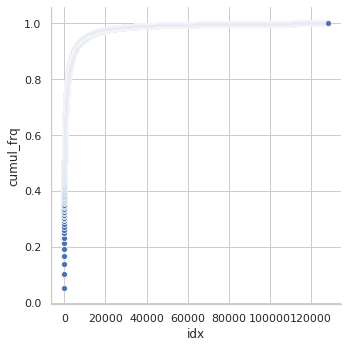

In [10]:
# Plot: Cumulative frequency by index
seaborn.relplot(x='idx', y='cumul_frq', data=frq)
plt.show()


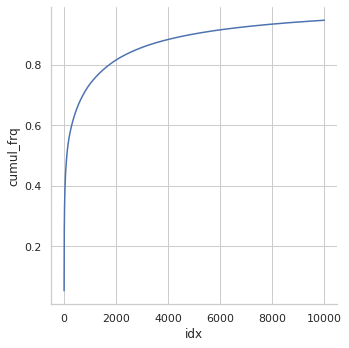

In [11]:

# Plot: Cumulative frequency by index, top 10000 tokens
seaborn.relplot(x='idx', y='cumul_frq', data=frq[:10000], kind='line')
plt.show()




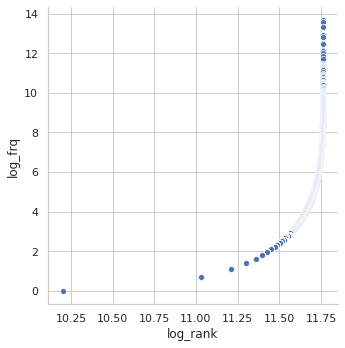

In [12]:

# Plot: Log-log plot for Zipf's law
frq['log_frq'] = numpy.log(frq.frequency)
frq['log_rank'] = numpy.log(frq.frequency.rank(ascending=True))
seaborn.relplot(x='log_rank', y='log_frq', data=frq)
plt.show()
pass

In [18]:
from nltk.tokenize import TweetTokenizer
from nltk.tokenize import  word_tokenize
tt = TweetTokenizer()
tweet = "This is a cooool #dummysmiley: :-) :-P <3 and some arrows < > -> <-- @remy: This is waaaaayyyy too much for you!!!!!!"
print(tt.tokenize(tweet))
print(word_tokenize(tweet))

# output
# ['This', 'is', 'a', 'cooool', '#dummysmiley', ':', ':-)', ':-P', '<3', 'and', 'some', 'arrows', '<', '>', '->', '<--', '@remy', ':', 'This', 'is', 'waaaaayyyy', 'too', 'much', 'for', 'you', '!', '!', '!']
# ['This', 'is', 'a', 'cooool', '#', 'dummysmiley', ':', ':', '-', ')', ':', '-P', '<', '3', 'and', 'some', 'arrows', '<', '>', '-', '>', '<', '--', '@', 'remy', ':', 'This', 'is', 'waaaaayyyy', 'too', 'much', 'for', 'you', '!', '!', '!', '!', '!', '!']


['This', 'is', 'a', 'cooool', '#dummysmiley', ':', ':-)', ':-P', '<3', 'and', 'some', 'arrows', '<', '>', '->', '<--', '@remy', ':', 'This', 'is', 'waaaaayyyy', 'too', 'much', 'for', 'you', '!', '!', '!']
['This', 'is', 'a', 'cooool', '#', 'dummysmiley', ':', ':', '-', ')', ':', '-P', '<', '3', 'and', 'some', 'arrows', '<', '>', '-', '>', '<', '--', '@', 'remy', ':', 'This', 'is', 'waaaaayyyy', 'too', 'much', 'for', 'you', '!', '!', '!', '!', '!', '!']
